In [1]:
using StatsBase
using GLM
using DataFrames
using Gadfly
using Cairo
using Fontconfig
using Formatting
using Compose, Colors

INFO: Recompiling stale cache file /home/kilian/.playground/packages/lib/v0.6/Gadfly.ji for module Gadfly.


In [2]:
# get the data into a DataFrame

fulldf = DataFrame()

probnames = [:foo, :galid, :groupid, :cenid, :rband, :Psat, :Mh, :foo2, :foo3, :foo4, :projR, :projrad, :angRh]
corrnames = [:foo5, :galid, :M_r, :M_g, :cz, :Dn4000, :H_delta, :logsSFR, :stelM, :ra, :dec, :vdisp, :S2N, :sersic,
             :conc, :KplusA, :R_exp, :surfdens1kpc, :surfdensR_e, :surfdensR_eo2, :vdisp_err, :Bulge2Tlr, :B2T_err,
             :GMoR_e, :R_e]

probfiles = ["dat/clf_groups_M18_M9.4.prob", "dat/clf_groups_M19_M9.8.prob", "dat/clf_groups_M20_M10.3.prob"]
corrfiles = ["dat/clf_groups_M18_M9.4.galdata_corr", "dat/clf_groups_M19_M9.8.galdata_corr", "dat/clf_groups_M20_M10.2.galdata_corr"]
densfiles = ["dat/density_r10.M18_M9.4", "dat/density_r10.M19_M9.8", "dat/density_r10.M20_M10.3"]
randfiles = ["dat/drandom_r10.M18_M9.4", "dat/drandom_r10.M19_M9.8", "dat/drandom_r10.M20_M10.3"]

for i in 1:3
    
    # read the two catalogues in and join them on galaxy id
    probdf = readtable(probfiles[i], separator=' ', header=false)
    names!(probdf, probnames)
    corrdf = readtable(corrfiles[i], separator=' ', header=false)
    names!(corrdf, corrnames)
    
    # add a column for the density, corrected with the randoms
    density = readdlm(densfiles[i])
    rands = readdlm(randfiles[i])
    ρ_corr = 1.25 * (density[:, 1] ./ rands[:, 1])
    probdf[:ρ_env] = DataArray(ρ_corr)
    
    joindf = join(probdf, corrdf, on=:galid)
   
    if i == 1
        fulldf = joindf
    else
        fulldf = [fulldf; joindf]
    end
end

fulldf = unique(fulldf, :galid)
    

# remove any galaxies in environment density less than or equal to zero, to avoid computational issues
fulldf = fulldf[fulldf[:ρ_env] .> 0.0, :]

# remove bad measurements of R_e, vdisp (i.e. where they are zero)
fulldf = fulldf[fulldf[:R_e] .> 0.0, :]
fulldf = fulldf[fulldf[:vdisp] .> 0.0, :]


# Take only the quenched galaxies
fulldf = fulldf[fulldf[:Dn4000] .> 1.6, :]

# add a column for log10 of stellar mass and log of environment
fulldf[:log10M] = log10.(fulldf[:stelM])
fulldf[:logρ] = log10.(fulldf[:ρ_env])
fulldf[:logρ2] = fulldf[:logρ] .^ 2
fulldf[:logM2] = fulldf[:log10M] .^ 2

# Now take all the rows out which don't have central galaxies
fulldf = fulldf[fulldf[:Psat] .< 0.5, :]

writedlm("M18_mags.dat", fulldf[:M_r])
# And a new df for "pure" centrals
# puredf = fulldf[fulldf[:Psat] .< 0.01, :]

In [4]:
function get_errbar(binpts)

    npts = length(binpts)
    ymean = mean(binpts)
    ystd = std(binpts)
    yerr = ystd / sqrt(npts)
    
    return ymean, yerr
end


function plot_binned_errs(x, y, bins)
    
    xedges = linspace(minimum(x), maximum(x), bins + 1)
    xmeans = [mean(x[xedges[i] .<= x .<= xedges[i + 1]]) for i in 1:bins]
    
    ymeans = []
    ymins = []
    ymaxs = []
    
    for i in 1:bins
        ymean, yerr = get_errbar(y[xedges[i] .<= x .<= xedges[i + 1]])
        append!(ymeans, ymean)
        append!(ymins, ymean - yerr)
        append!(ymaxs, ymean + yerr)
    end
    
    plot(x=xmeans, y=ymeans, ymin=ymins, ymax=ymaxs, Geom.point, Geom.errorbar)
end

plot_binned_errs (generic function with 1 method)

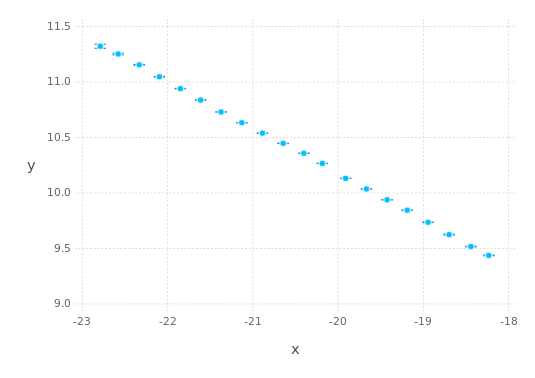

In [5]:
plot_binned_errs(fulldf[:M_r], log10.(fulldf[:stelM]), 20)

In [6]:
fulldf[:logstelM] = log10.(fulldf[:stelM])
fulldf[:cutM_r] = cut(-1 .* fulldf[:M_r], 20)
plot(fulldf, x="cutM_r", y="stelM", Geom.boxplot)
println("meh")

meh


In [3]:
# load in the halo data

halocols = [:halo_id, :halo_upid, :x, :y, :z, :vx, :vy, :vz, :hfoo1, :hfoo2, :halo_mvir, :halo_mz_05, :halo_mz_1,
            :halo_mz_2, :halo_mz_4, :halo_mz_8, :halo_ac, :halo_ac_mpeak, :halo_nfw_conc, :halo_spin, :hfoo3, :halo_rvir]
halodf = readtable("./dat/halodat/halo_merge_rvir.dat", separator=' ', header=false)
names!(halodf, halocols)


,halo_id,halo_upid,x,y,z,vx,vy,vz,hfoo1,hfoo2,halo_mvir,halo_mz_05,halo_mz_1,halo_mz_2,halo_mz_4,halo_mz_8,halo_ac,halo_ac_mpeak,halo_nfw_conc,halo_spin,hfoo3,halo_rvir
1,1620490488,-1,23.89081,178.3519,71.89722,254.19,-195.17,-253.54,758.46,780.72,1.303e14,1.117e14,1.016e14,9.289e13,6.113e13,4.885e13,0.5146198,0.5146198,4.34886,0.03889,1620490488,1.2514080087741974
2,1620489517,-1,54.23852,147.2122,83.84457,132.18,-243.42,241.66,746.88,787.27,1.031e14,1.009e14,9.834e13,8.531e13,6.773e13,5.168e13,0.6029879,0.6029879,6.31183,0.03163,1620489517,1.1574538395105791
3,1620568787,-1,17.50353,142.1473,121.2332,206.25,52.6,75.76,800.83,833.51,1.023e14,9.305e13,8.565e13,8.209e13,7.753e13,5.354e13,0.4655995,0.4655995,8.92032,0.01292,1620568787,1.1544523249944771
4,1620569234,-1,30.92994,185.0855,116.1488,100.4,211.18,314.45,759.85,808.61,8.734e13,8.65e13,8.481e13,7.882e13,6.102e13,4.87e13,0.4749017,0.4749017,8.7816,0.02291,1620569234,1.0951876068562183
5,1620569405,-1,3.68962,147.0322,119.6417,318.78,-36.68,214.57,655.71,762.05,7.256e13,7.268e13,7.435e13,8.4e13,7.07e13,2.074e13,0.5798712,0.6080615,5.65232,0.0223,1620569405,1.0295557840966265
6,1619882298,-1,46.93332,134.8692,85.29067,-32.87,0.42,29.38,664.42,737.05,7.239e13,6.482e13,6.325e13,6.602e13,6.553e13,2.278e13,0.7345032,0.7345032,6.13975,0.06525,1619882298,1.0287511104972473
7,1620570495,-1,10.00246,186.1661,125.9586,173.74,249.63,270.22,650.17,679.69,6.975e13,6.799e13,6.33e13,6.143e13,5.133e13,3.735e13,0.5291948,0.5291948,6.26543,0.04754,1620570495,1.016090042702695
8,1621113337,-1,39.21831,196.0848,87.00575,-92.91,99.81,237.01,560.58,643.33,5.08e13,5.55e13,5.615e13,6.024e13,3.472e13,1.32e13,0.5035906,0.5166789,4.35401,0.08217,1621113337,0.9141946924586767
9,1620494893,-1,38.97719,181.1835,67.20104,-119.43,12.79,11.14,568.63,639.93,4.591e13,4.567e13,4.37e13,4.085e13,3.21e13,1.713e13,0.4732067,0.4752914,6.38986,0.03874,1620494893,0.8838662598579571
10,1620494673,-1,28.94529,165.5476,73.521,28.3,-4.23,-105.61,586.93,628.04,4.428e13,4.125e13,3.994e13,3.841e13,3.449e13,2.469e13,0.3816226,0.3816226,7.59335,0.03238,1620494673,0.8732796277894088


In [8]:
function closest_index(x, val) 
    ibest = start(eachindex(x)) 
    dxbest = abs(x[ibest]-val) 
    for I in eachindex(x) 
        dx = abs(x[I]-val) 
        if dx < dxbest 
            dxbest = dx 
            ibest = I 
        end 
    end 
    ibest 
end

closest_index (generic function with 1 method)

In [14]:
writedlm("Mh.dat", fulldf[:Mh])
writedlm("M_r.dat", fulldf[:M_r])
writedlm("stelM.dat", fulldf[:stelM])
writedlm("halomass.dat", halodf[:halo_mvir])

In [12]:
# create central M_star and M_r columns for central gals in each halo

cenM_star = []
cenM_r = []

for halomass in halodf[:halo_mvir]
    
    gal_id = indmin(abs.(fulldf[:Mh] - halomass))
    push!(cenM_star, fulldf[:stelM][gal_id])
    push!(cenM_r, fulldf[:M_r][gal_id])
    
end

halodf[:cenM_star] = cenM_star
halodf[:cenM_r] = cenM_r

LoadError: [91mInterruptException:[39m

In [ ]:
writedlm("dat/halodat/cen_Mstar.dat", cenM_star)
writedlm("dat/halodat/cen_M_r.dat", cenM_r)

In [22]:
cenM_star = readdlm("cenM_star.dat")
cenM_r = readdlm("cenM_r.dat")

println(length(halodf[:halo_mvir]))

1875265


In [23]:
# get some age-matching done

# first make the stellar mass bins in logspace
nbins = 10
fulldf[:logstelM] = log10.(fulldf[:stelM])
max_stelM = maximum(fulldf[:logstelM])
min_stelM = minimum(fulldf[:logstelM])
stelMbins = linspace(min_stelM, max_stelM, nbins + 1)

# now loop through bins and assign Dn4000 to mock centrals according to halo age

ranDn4k = zeros(length(halodf[:halo_mvir]))
ageDn4k = zeros(length(halodf[:halo_mvir]))

for i in 1:bins
    
    bingalids = stelMbins[i] .<= fulldf[:logstelM] .< stelMbins[i + 1]
    quengals = fulldf[:Dn4000][bingalids]
    
    println("done")
    
    mockcens = stelMbins[i] .<= log10.(cenM_star) .< stelMbins[i + 1]
    mockages = halodf[:halo_ac_mpeak][mockcens]
    
    println("so far so good")
    
    # rank the halo ages
    ageinds = sortperm(mockages)
    
    nsamples = length(mockcens)
    quenmock = rand(quengals, nsamples)
    
    # assign random Dn4000 in one column
    ranDn4k[mockcens] = quenmock
    
    println("still good")
    
    # rank Dn4k to match to ages
    queninds = sortperm(quenmock, rev=true)
    
    ageDn4k[mockcens] = quenmock[queninds][ageinds]
    
end

halodf[:halo_Dn4k] = ageDn4k
halodf[:halo_Dn4k_rand] = ranDn4k

    

done


LoadError: [91mBoundsError: attempt to access 1875265-element DataArrays.DataArray{Float64,1} at index [Base.LogicalIndex(Bool[false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; false; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true; true])][39m